In [63]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable
import torchvision.models as models
import time
import random
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import patches, patheffects
import pandas as pd
from PIL import ImageDraw, ImageFont
from collections import namedtuple, OrderedDict
from session import *
from LR_Schedule.cos_anneal import CosAnneal
from LR_Schedule.cyclical import Cyclical
from LR_Schedule.lr_find import lr_find
from callbacks import *
from validation import *
from Vision.ImageHelpers import *
from Vision.SSD import *
from Datasets.RoadDamage import RoadDamageDataset

In [64]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [65]:
torch.cuda.set_device(0); torch.backends.cudnn.benchmark=True

In [66]:
imsize = 448
batch_size = 32
data, classes, train_tfms, val_tfms, denorm = RoadDamageDataset('../storage/road_damage_data', imsize, batch_size)
num_classes = len(classes) - 1
classes

['bg', 'D00', 'D01', 'D10', 'D11', 'D20', 'D40', 'D43', 'D44']

In [67]:
num_colr = 12
cmap = get_cmap(num_colr)
colr_list = [cmap(float(x)) for x in range(num_colr)]

def show_ground_truth(ax, x, bbox, clas=None, prs=None, thresh=0.3, show_bg=False):
    im = np.moveaxis(x, 0, 2)
    bb = [center_to_hw(o) for o in bbox.reshape(-1,4)]
    if prs is None:  prs  = [None]*len(bb)
    if clas is None: clas = [None]*len(bb)
    ax = show_img(im.clip(0,1), ax=ax)
    for i,(b,c,pr) in enumerate(zip(bb, clas, prs)):
        if((b[2]>0) and (pr is None or pr > thresh) and (show_bg or c != 0)):
            draw_rect(ax, b, color=colr_list[i%num_colr])
            txt = f'{i}: '
            if c is not None: txt += classes[c]
            if pr is not None: txt += f' {pr:.2f}'
            draw_text(ax, b[:2], txt, color=colr_list[i%num_colr])
            
def torch_gt(ax, ima, bbox, clas, prs=None, thresh=0.25, show_bg=False):
    return show_ground_truth(ax, ima, (bbox*imsize),
         clas, prs if prs is not None else None, thresh, show_bg=show_bg)

def test(sess, anchors, grid_sizes, data):
    with EvalModel(sess.model):
        rawx, rawy, *_ = next(iter(data))
        pred_classes, bb_outputs = sess.forward(rawx)
        prints = {key: val.numpy() for key, val in rawy.items()}
        y = {key: Variable(value) for key, value in rawy.items()}

        for i, x in enumerate(rawx[0:16]):
            im = denorm(rawx[i]).numpy()

            pred_classes_1, bb_outputs_1 = pred_classes[i], bb_outputs[i]
            label_bbs, label_classes = y['BB'][i], y['CAT'][i]

            fig, axes = plt.subplots(3, 2, figsize=(18, 18))


            # Ground Truth
            show_ground_truth(axes.flat[0], im, prints['BB'][i], prints['CAT'][i])


            # Anchorbox Assignments 
            gt_bbs, gt_classes, *_ = map_label_to_ground_truth(label_bbs, label_classes, anchors, imsize)
            torch_gt(axes.flat[1], im, anchors.cpu().data.numpy(), gt_classes.cpu().data.numpy(), show_bg=False)


            # Predicted classes per anchorbox
            torch_gt(axes.flat[2], im, 
                     anchors.cpu().data.numpy(), 
                     pred_classes_1.max(1)[1].data, 
                     pred_classes_1.max(1)[0].sigmoid().data, 
                     show_bg=True)


            # Predicted classes per anchorbox. No background
            torch_gt(axes.flat[3], im, 
                     anchors.cpu().data.numpy(), 
                     pred_classes_1[:,1:].max(1)[1].data + 1, 
                     pred_classes_1[:,1:].max(1)[0].sigmoid().data, 
                     thresh=0.15,
                     show_bg=False)


            # Predicted class and bounding box
            a_ic = map_bb_outputs_to_pred_bbs(bb_outputs_1, anchors, grid_sizes)
            torch_gt(axes.flat[4], im, 
                     a_ic.cpu().data.numpy(), 
                     pred_classes_1[:,1:].max(1)[1].data + 1, 
                     pred_classes_1[:,1:].max(1)[0].sigmoid().data, 
                     thresh=0.15, 
                     show_bg=False)


            # Non Maximum Supression Outputs
            nms_classes, nms_conf, nms_bbs = make_output(pred_classes_1, bb_outputs_1, anchors, grid_sizes)
            nms_bbs_as_numpy = torch_corners_to_center(nms_bbs.cpu()).numpy()
            torch_gt(axes.flat[5], im, nms_bbs_as_numpy, nms_classes.cpu().numpy(), nms_conf.cpu().numpy())

In [68]:
class StdConv(nn.Module):
    def __init__(self, n_in, n_out, stride=2, drop_p=0.1):
        super().__init__()
        self.conv = nn.Conv2d(n_in, n_out, 3, stride=stride, padding=1)
        self.relu = nn.ReLU(inplace=True)
        self.batch_norm = nn.BatchNorm2d(n_out)
        self.dropout = nn.Dropout(drop_p)
        
    def forward(self, x):
        return self.dropout(self.batch_norm(self.relu(self.conv(x))))

In [69]:
def flatten_conv(x,k=1):
    bs,nf,gx,gy = x.size()
    x = x.permute(0,2,3,1).contiguous()
    return x.view(bs,-1,nf//k)

class SSDOut(nn.Module):
    def __init__(self, n_in, k=1):
        super().__init__()
        self.out_classes = nn.Conv2d(n_in, (num_classes + 1) * k, 3, padding=1) # Output for each class + background class
        self.out_boxes = nn.Conv2d(n_in, 4*k, 3, padding=1) # Output for bounding boxes
        
    def forward(self, x):
        return [flatten_conv(self.out_classes(x), k), F.tanh(flatten_conv(self.out_boxes(x), k))]

class SSDHead(nn.Module):
    def __init__(self):
        super().__init__()
        self.dropout = nn.Dropout(0.1)
        self.conv_0 = StdConv(512, 256, stride=1)
        self.conv_1 = StdConv(256, 256)
        self.out = SSDOut(256)
        
    def forward(self, x):
        x = self.dropout(F.relu(x))
        x = self.conv_0(x)
        x = self.conv_1(x)
        return self.out(x)
        

## More Anchors

In [70]:
def var_from_np(arr, requires_grad=True):
    return Variable(torch.from_numpy(arr), requires_grad=requires_grad)

In [71]:
anc_grids = [4,2,1]

anc_zooms = [1., .7]

anc_ratios = [(1.,1.), (1, .5), (.5, 1)]

anchor_scales = [(anz*i,anz*j) for anz in anc_zooms for (i,j) in anc_ratios]

# print(anchor_scales)

k = len(anchor_scales)

anc_offsets = [1/(o*2) for o in anc_grids]

k

6

In [72]:
anc_x = np.concatenate([np.repeat(np.linspace(ao, 1-ao, ag), ag) for ao, ag in zip(anc_offsets, anc_grids)])

# print(anc_x)

anc_y = np.concatenate([np.tile(np.linspace(ao, 1-ao, ag), ag) for ao, ag in zip(anc_offsets, anc_grids)])

# print(anc_y)

anc_ctrs = np.repeat(np.stack([anc_x,anc_y], axis=1), k, axis=0)

# print(anc_ctrs)

In [73]:
anc_sizes = np.concatenate([np.array([[o/ag,p/ag] for i in range(ag*ag) for o, p in anchor_scales])
               for ag in anc_grids])

grid_sizes = var_from_np(np.concatenate([np.array([1/ag for i in range(ag*ag) for o, p in anchor_scales])
               for ag in anc_grids]), requires_grad=False).unsqueeze(1).float()

anchors = var_from_np(np.concatenate([anc_ctrs, anc_sizes], axis=1), requires_grad=False).float()

In [74]:
# anchors

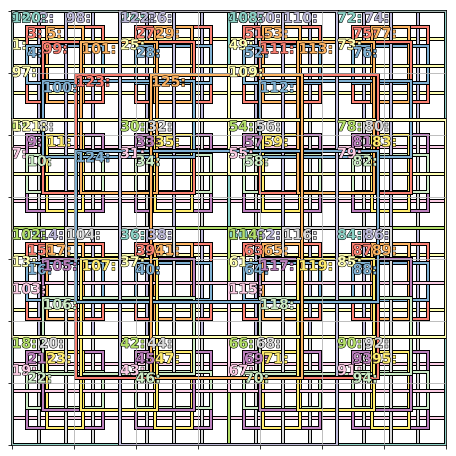

In [75]:
fig, ax = plt.subplots(figsize=(8, 8))
show_ground_truth(ax, np.ones((3, 224, 224)), anchors.data.cpu().numpy() * 224)

In [76]:
class SSD_MultiHead(nn.Module):
    def __init__(self, k, bias):
        super().__init__()
        self.drop = nn.Dropout(.4)
        self.sconv0 = StdConv(512,256, stride=2, drop_p=.4)
        self.sconv1 = StdConv(256,256, drop_p=.4)
        self.sconv2 = StdConv(256,256, drop_p=.4)
        self.sconv3 = StdConv(256,256, drop_p=.4)
        self.out0 = SSDOut(256, k)
        self.out1 = SSDOut(256, k)
        self.out2 = SSDOut(256, k)
        self.out3 = SSDOut(256, k)

    def forward(self, x):
        x = self.drop(F.relu(x))
        x = self.sconv0(x)
        x = self.sconv1(x)
        o1c,o1l = self.out1(x)
        x = self.sconv2(x)
        o2c,o2l = self.out2(x)
        x = self.sconv3(x)
        o3c,o3l = self.out3(x)
        return [torch.cat([o1c,o2c,o3c], dim=1),
                torch.cat([o1l,o2l,o3l], dim=1)]

In [77]:
model_ft = models.resnet34(pretrained=True)
layers = list(model_ft.children())[0:-2]
layers += [SSD_MultiHead(k, -4.)]
model = nn.Sequential(*list(layers))
criterion = SSDLoss(anchors, grid_sizes, num_classes, imsize)
optim_fn = optim.Adam
sess = Session(model, criterion, optim_fn, [*[1e-3] * 8, 1e-2])

In [78]:
# rawx,rawy,*_ = next(iter(data['valid']))
# y = {key: Variable(value) for key, value in rawy.items()}

In [79]:
# batch = sess.forward(rawx)
# ssd_loss(batch, y)

In [80]:
# test(sess, anchors, data['valid'])

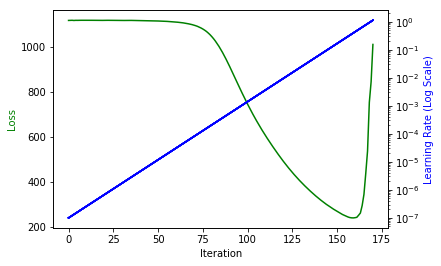

In [46]:
lr_find(sess, data['train'], start_lr=1e-7)

In [47]:
sess.set_lr([*[1e-3 / 2] * 8, 1e-3])

In [48]:
lr_scheduler = Cyclical(len(data['train']) * 16)
accuracy = JaccardAccuracy(anchors, grid_sizes, imsize)
validator = Validator(data['valid'], accuracy)
schedule = TrainingSchedule(data['train'], [lr_scheduler, validator])

In [49]:
sess.train(schedule, 16)

Training Loss: 126.543080  Validaton Loss: 60.177173 Validation Accuracy: 0.000650


Training Loss: 24.103923  Validaton Loss: 16.035630 Validation Accuracy: 0.000000


Training Loss: 14.514601  Validaton Loss: 13.711853 Validation Accuracy: 0.013830


Training Loss: 13.337201  Validaton Loss: 12.921679 Validation Accuracy: 0.058261


Training Loss: 12.476446  Validaton Loss: 12.243502 Validation Accuracy: 0.163721


Training Loss: 11.663558  Validaton Loss: 11.231781 Validation Accuracy: 0.206800


Training Loss: 10.965241  Validaton Loss: 10.997299 Validation Accuracy: 0.226635


Training Loss: 10.444873  Validaton Loss: 10.315101 Validation Accuracy: 0.280062


Training Loss: 10.133782  Validaton Loss: 10.223513 Validation Accuracy: 0.287569


Training Loss: 9.710788  Validaton Loss: 9.888785 Validation Accuracy: 0.333736


Training Loss: 9.379645  Validaton Loss: 9.813025 Validation Accuracy: 0.342067


Training Loss: 9.103823  Validaton Loss: 9.600894 Validation Accuracy: 0.388239


Training Loss: 8.635626  Validaton Loss: 9.395469 Validation Accuracy: 0.379762


Training Loss: 8.314723  Validaton Loss: 9.128431 Validation Accuracy: 0.405167


Training Loss: 7.944991  Validaton Loss: 9.071634 Validation Accuracy: 0.428040


Training Loss: 7.688149  Validaton Loss: 8.912150 Validation Accuracy: 0.434152


In [ ]:
# sess.save("../artifacts/Resnet34MultiMoreAnchors")

In [ ]:
# sess.load("../artifacts/Resnet34MultiMoreAnchors")

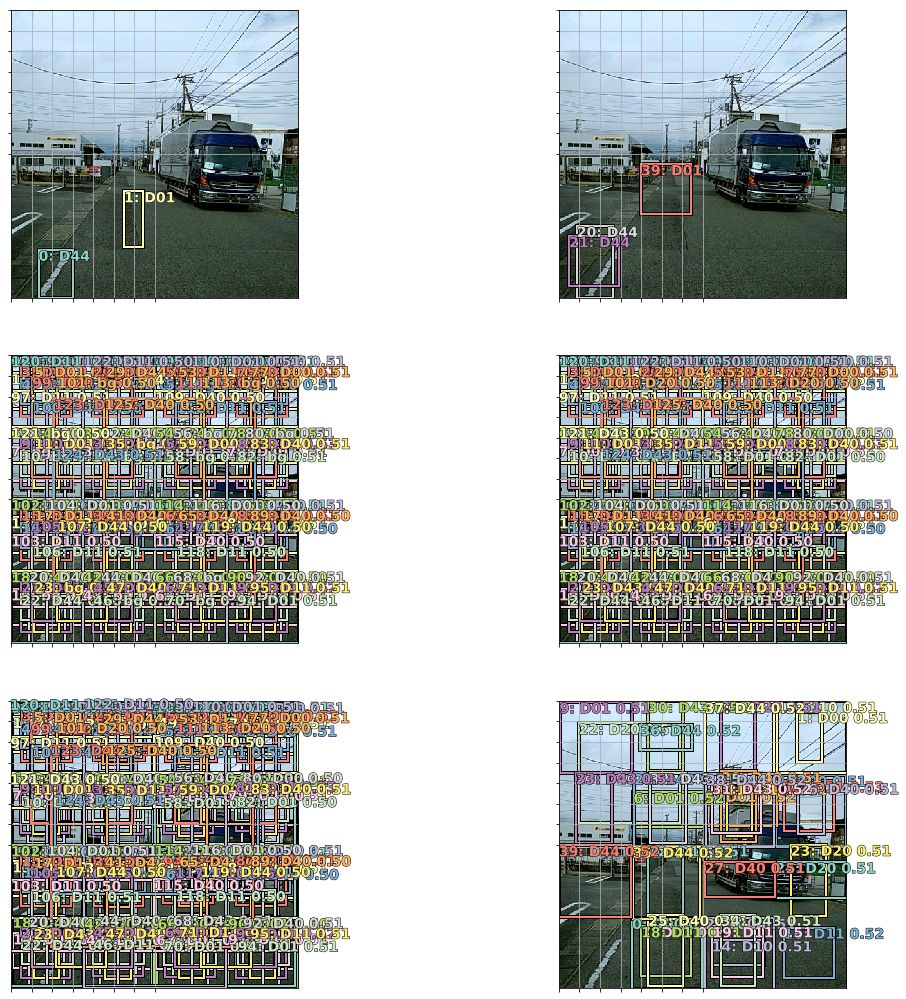

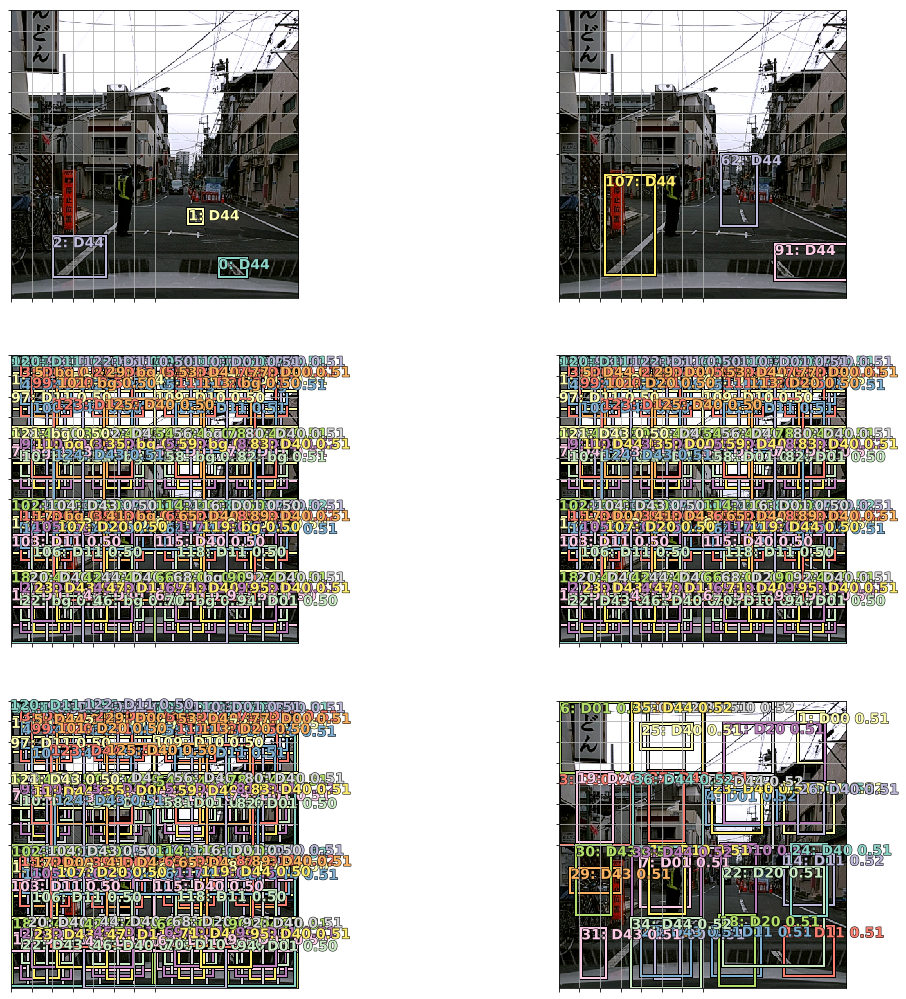

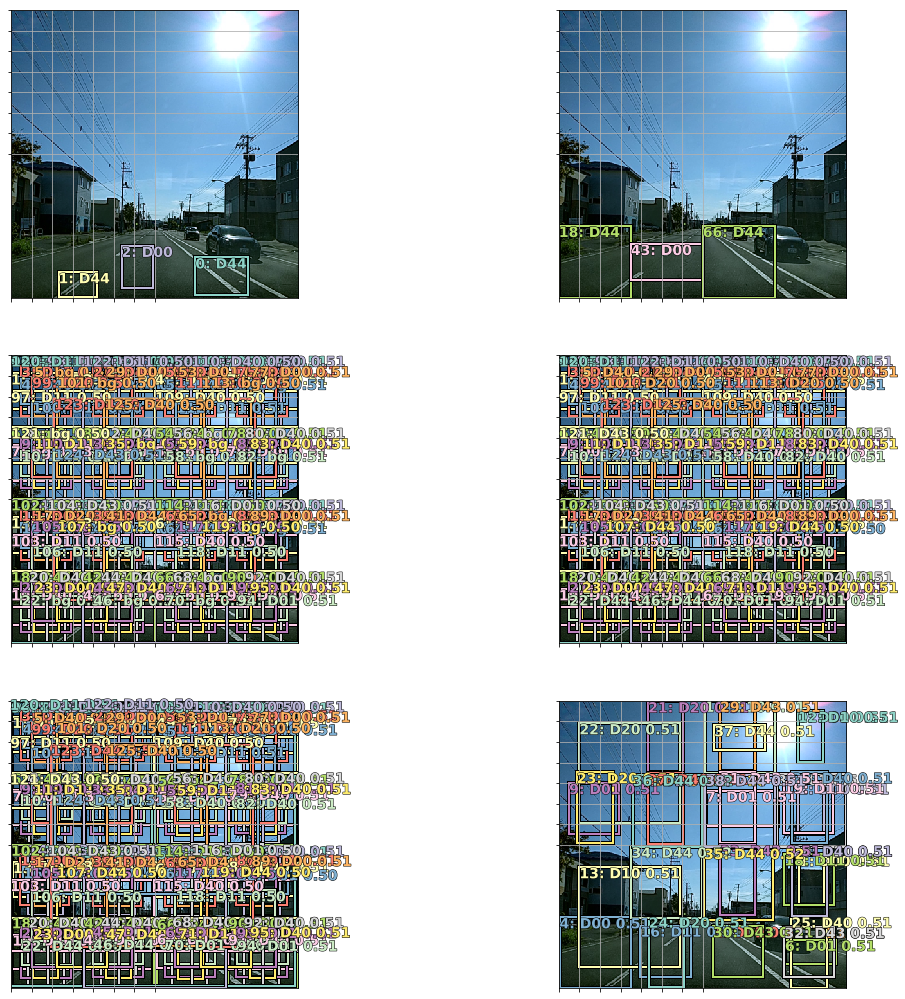

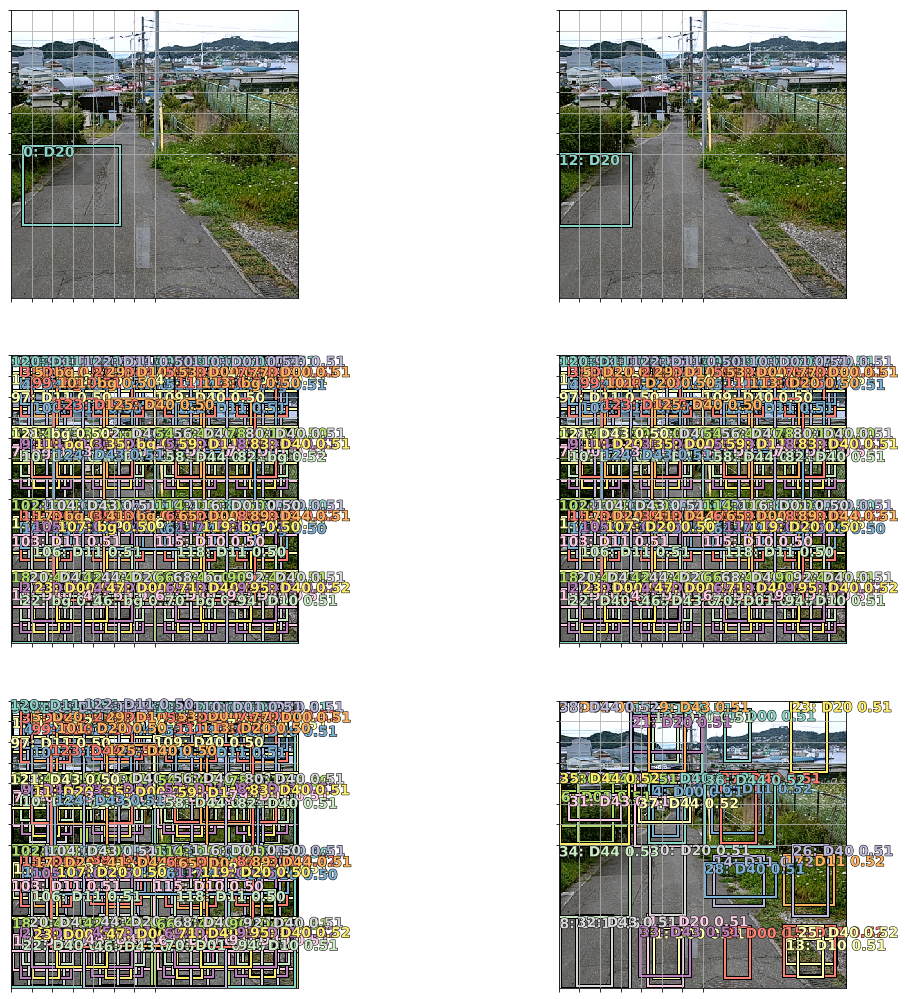

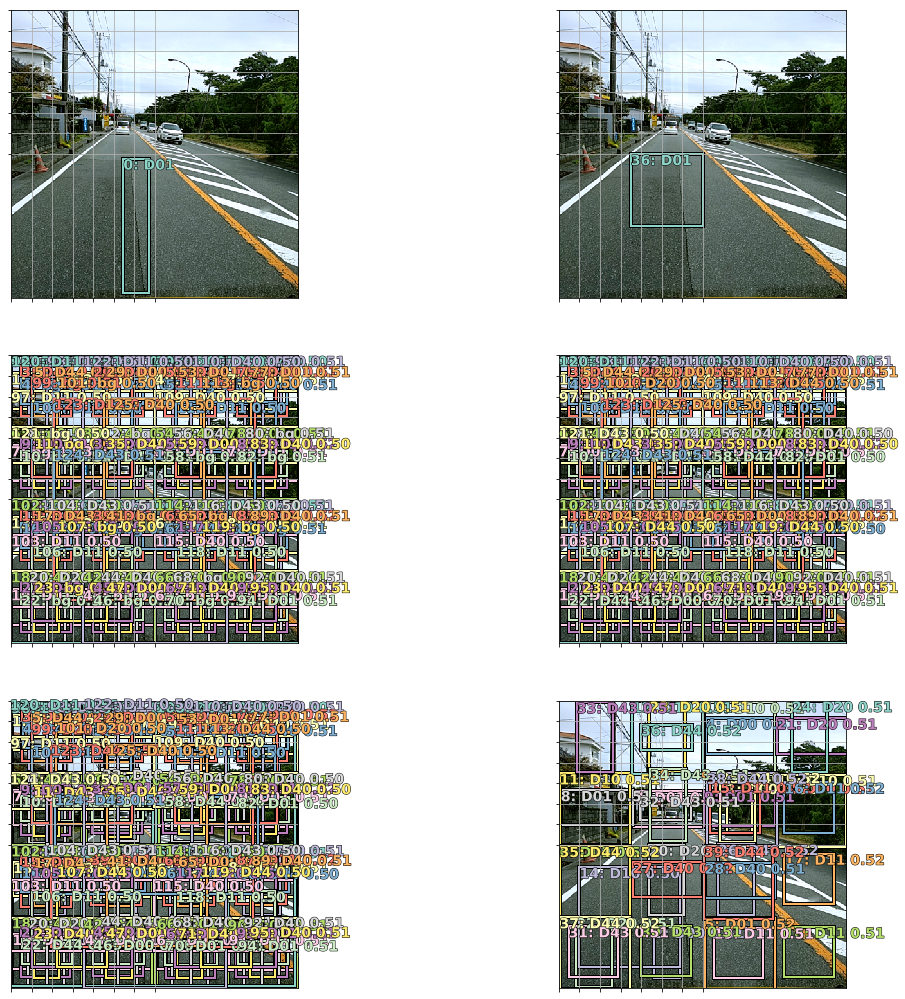

...

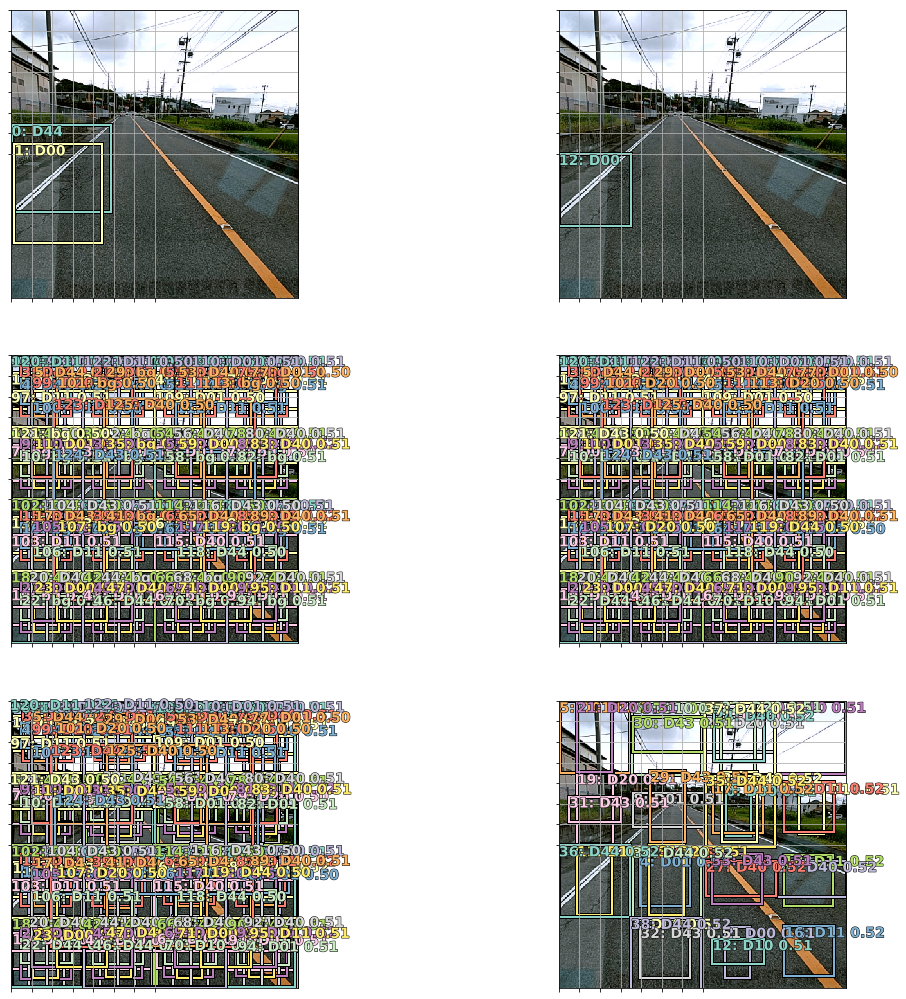

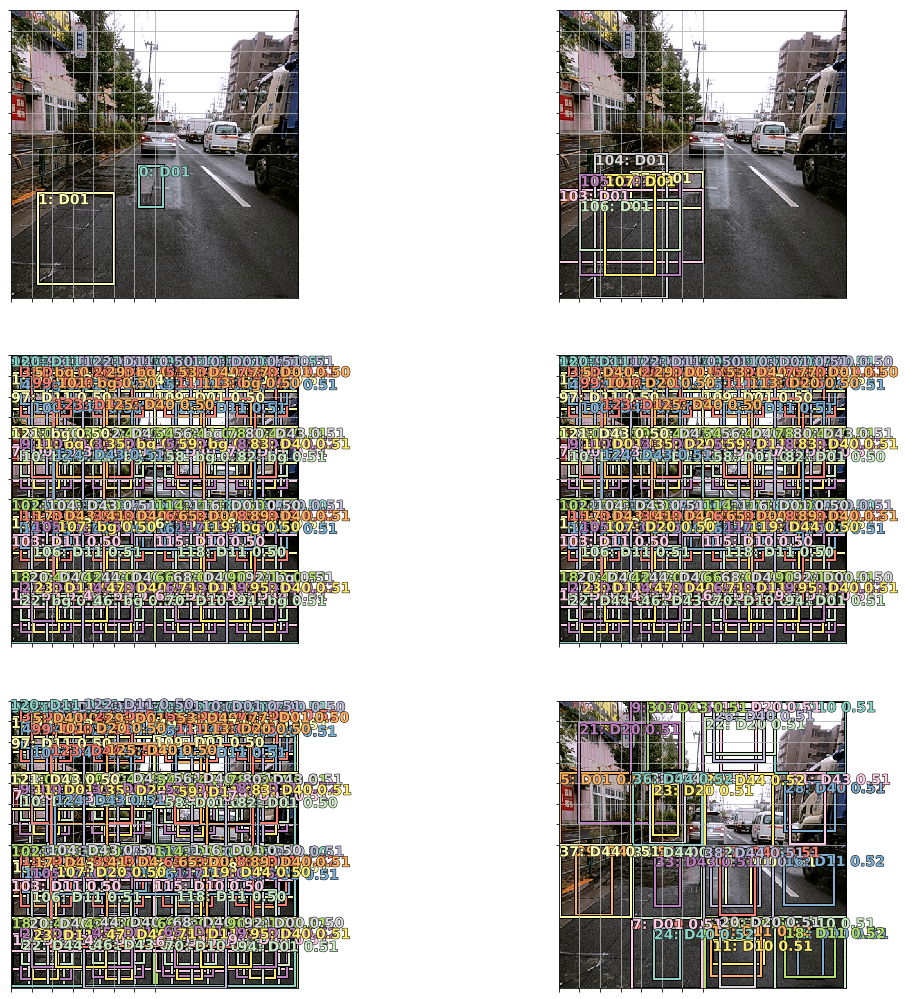

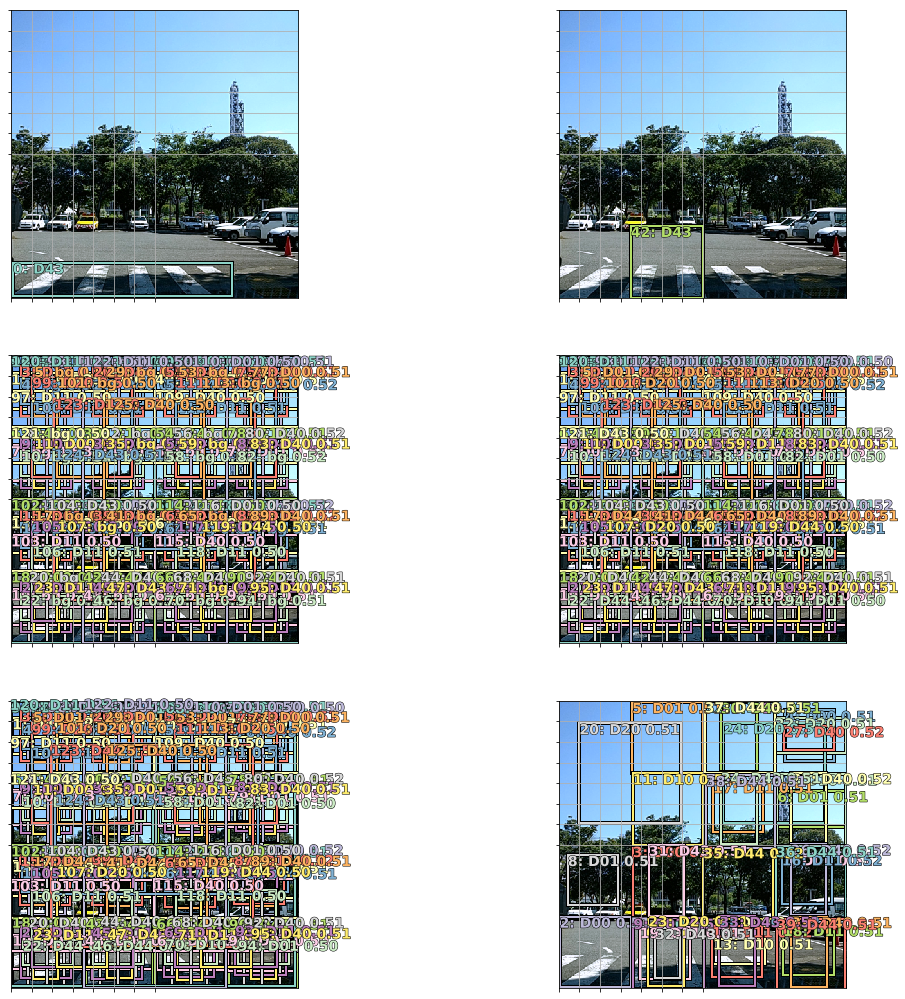

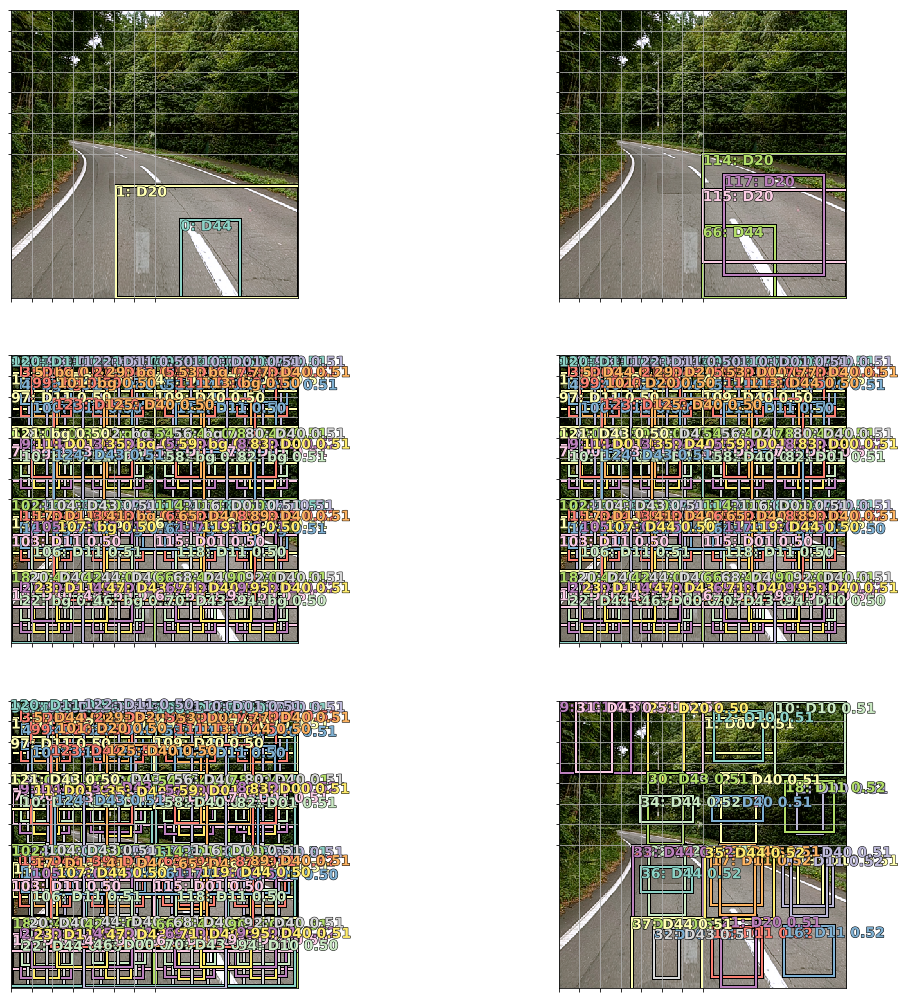

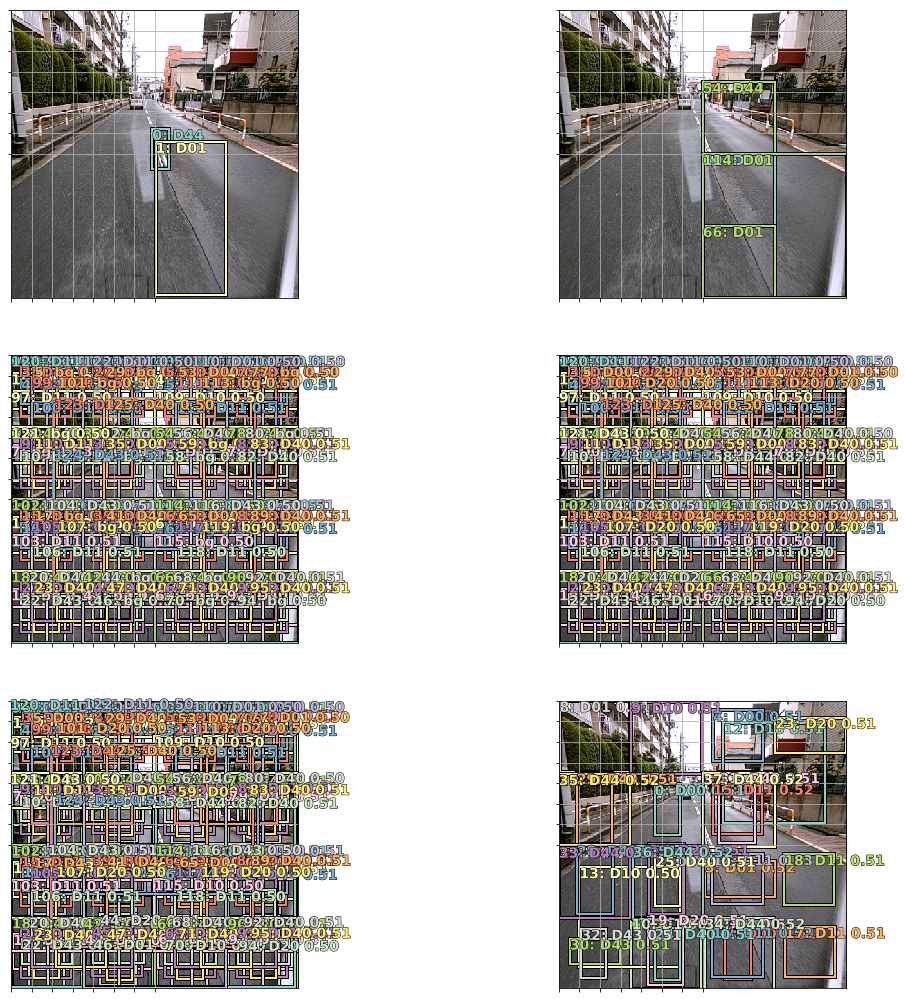

In [81]:
test(sess, anchors, grid_sizes, data['valid'])

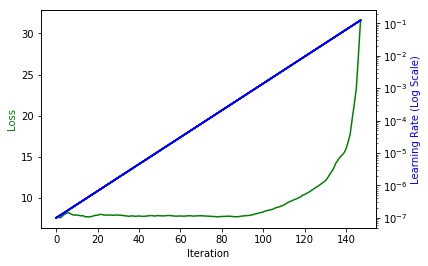

In [51]:
lr_find(sess, data['train'], start_lr=1e-7)

In [52]:
sess.set_lr([*[1e-4 / 2] * 8, 1e-4])

In [53]:
lr_scheduler = Cyclical(len(data['train']) * 16, div=32, cut_div=4)
validator = Validator(data['valid'], JaccardAccuracy())
schedule = TrainingSchedule(data['train'], [lr_scheduler, validator])

In [54]:
sess.train(schedule, 16)

Training Loss: 7.858823  Validaton Loss: 9.380951 Validation Accuracy: 0.416744


Training Loss: 8.720092  Validaton Loss: 10.076284 Validation Accuracy: 0.342292


Training Loss: 9.154470  Validaton Loss: 10.108702 Validation Accuracy: 0.339390


Training Loss: 9.602165  Validaton Loss: 10.251080 Validation Accuracy: 0.302841


Training Loss: 9.079007  Validaton Loss: 10.074315 Validation Accuracy: 0.325968


Training Loss: 8.767914  Validaton Loss: 9.507752 Validation Accuracy: 0.362435


Training Loss: 8.456810  Validaton Loss: 9.414992 Validation Accuracy: 0.384438


Training Loss: 8.186838  Validaton Loss: 9.259625 Validation Accuracy: 0.405145


Training Loss: 7.910337  Validaton Loss: 8.949055 Validation Accuracy: 0.421546


Training Loss: 7.576798  Validaton Loss: 9.015098 Validation Accuracy: 0.420606


Training Loss: 7.324618  Validaton Loss: 8.878000 Validation Accuracy: 0.451740


Training Loss: 6.996993  Validaton Loss: 8.673688 Validation Accuracy: 0.459398


Training Loss: 6.719577  Validaton Loss: 8.672370 Validation Accuracy: 0.483909


Training Loss: 6.465278  Validaton Loss: 8.603344 Validation Accuracy: 0.490109


Training Loss: 6.147097  Validaton Loss: 8.442630 Validation Accuracy: 0.482677


Training Loss: 5.936510  Validaton Loss: 8.280480 Validation Accuracy: 0.500436


In [56]:
# sess.save("../artifacts/Resnet34MultiCyclical")

In [57]:
sess.load("../artifacts/Resnet34MultiCyclical")

In [ ]:
validator.run(sess)

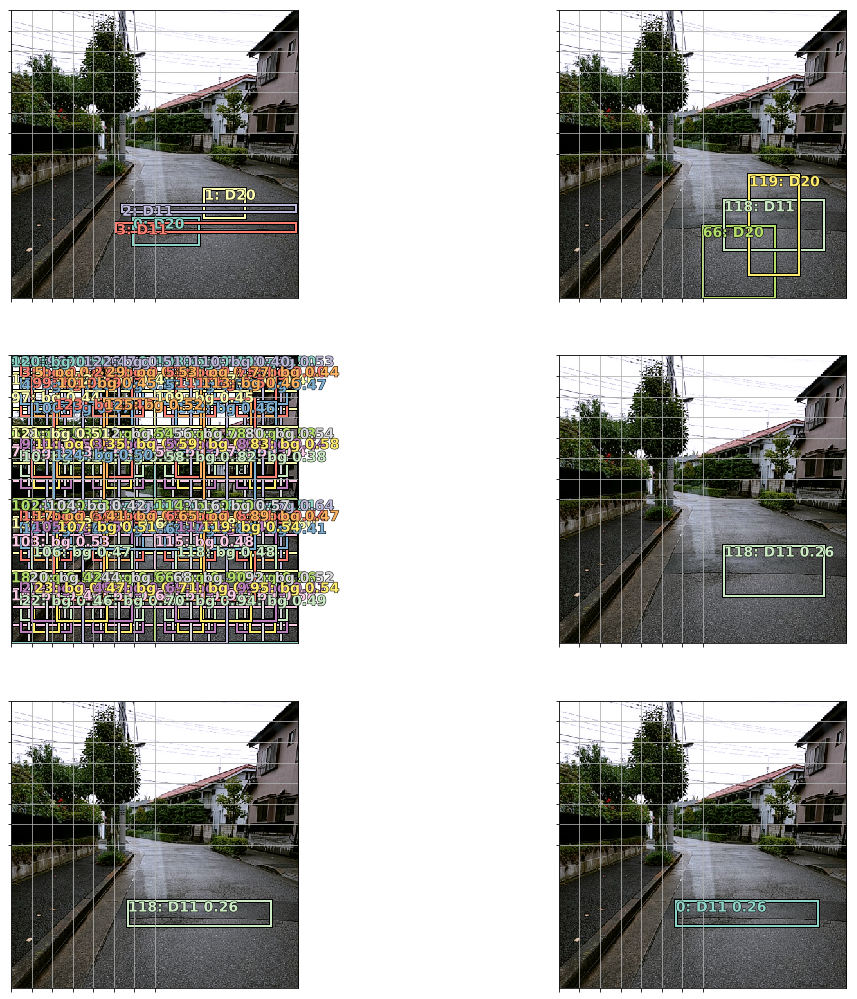

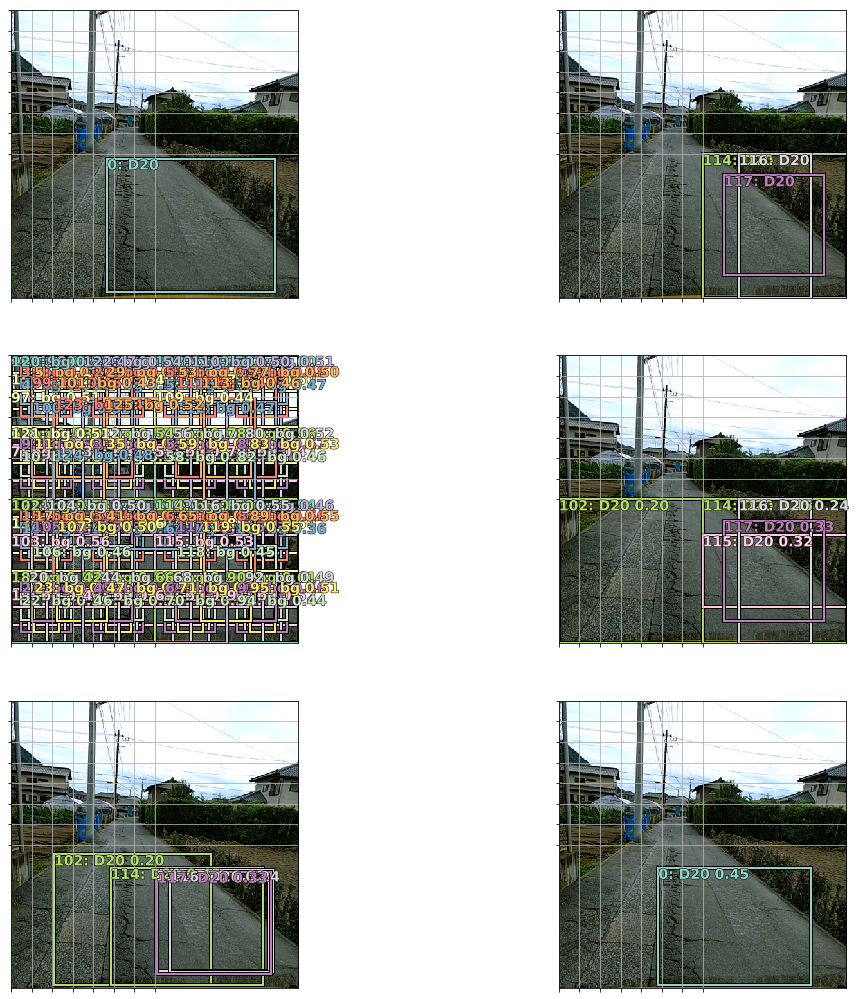

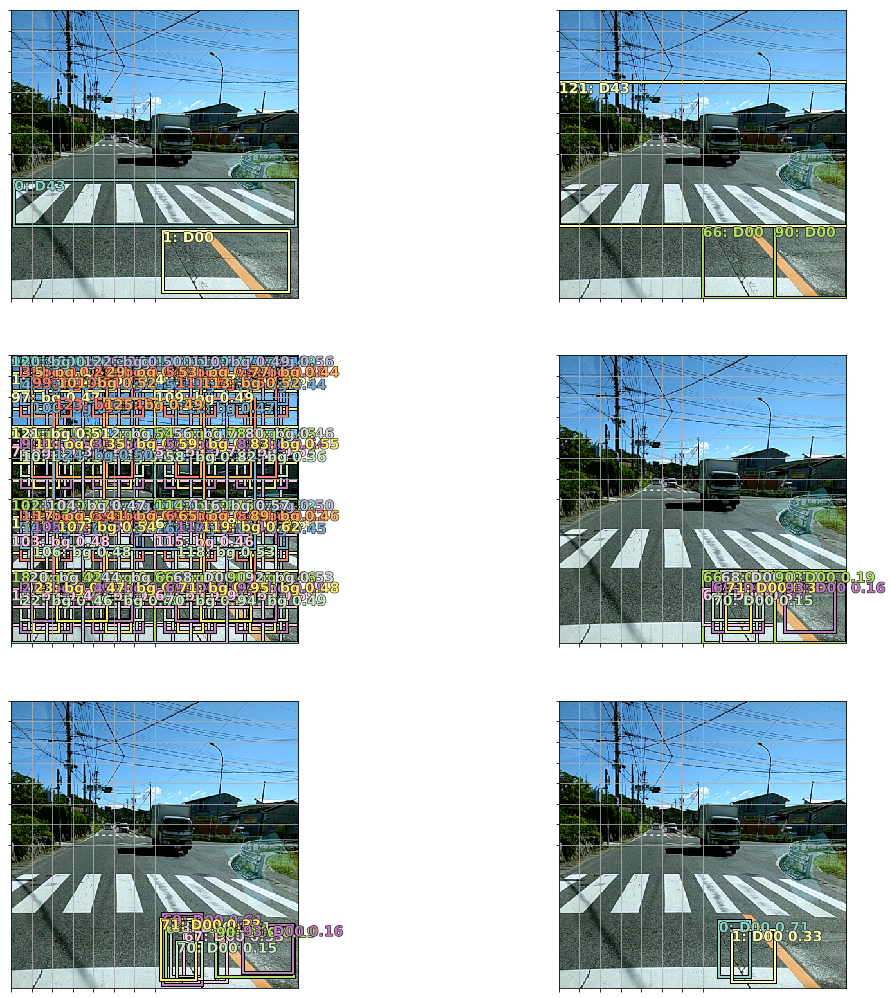

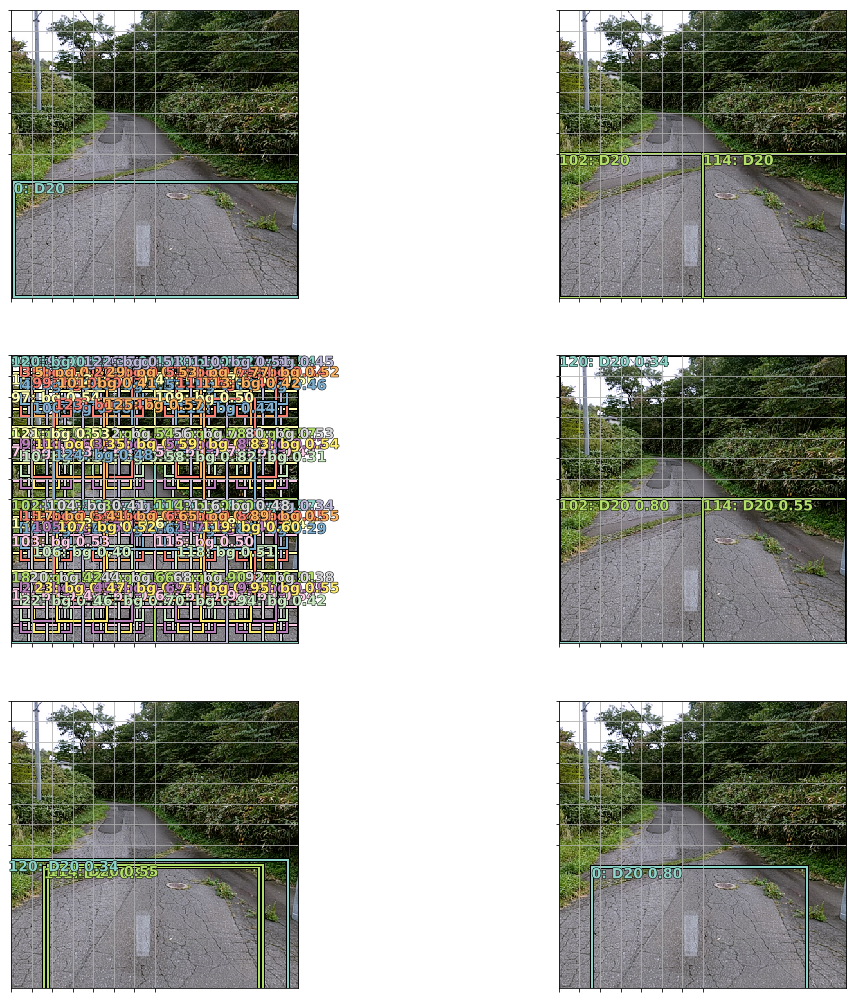

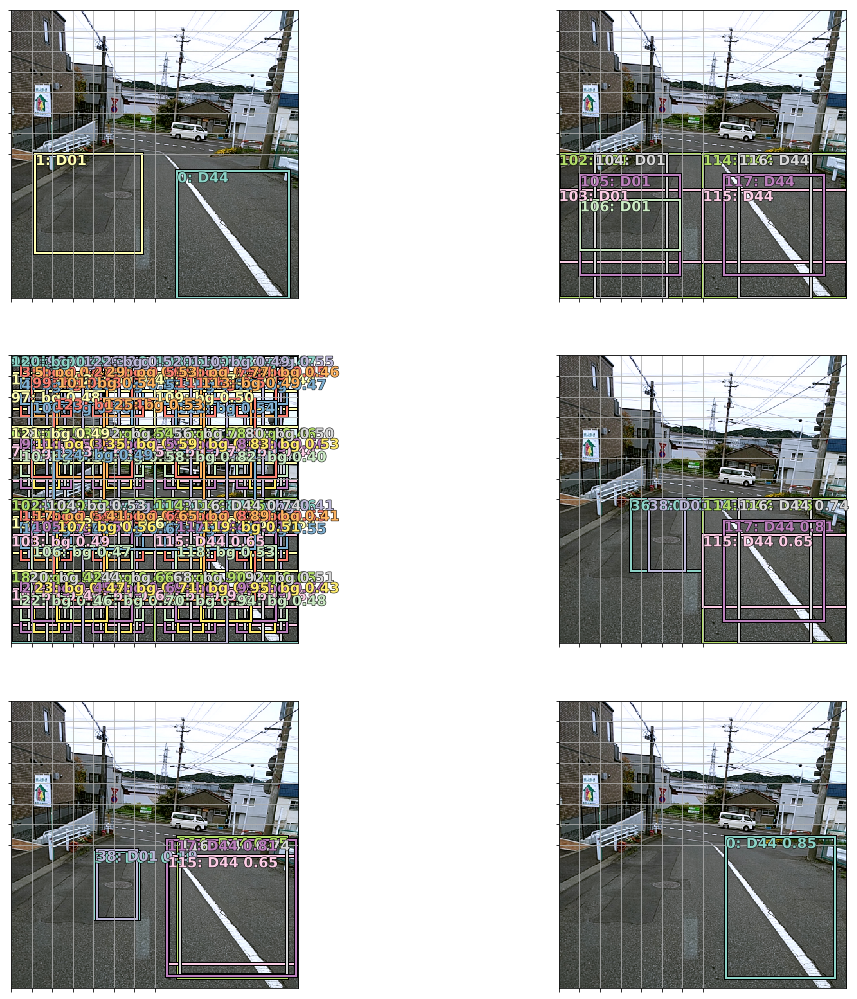

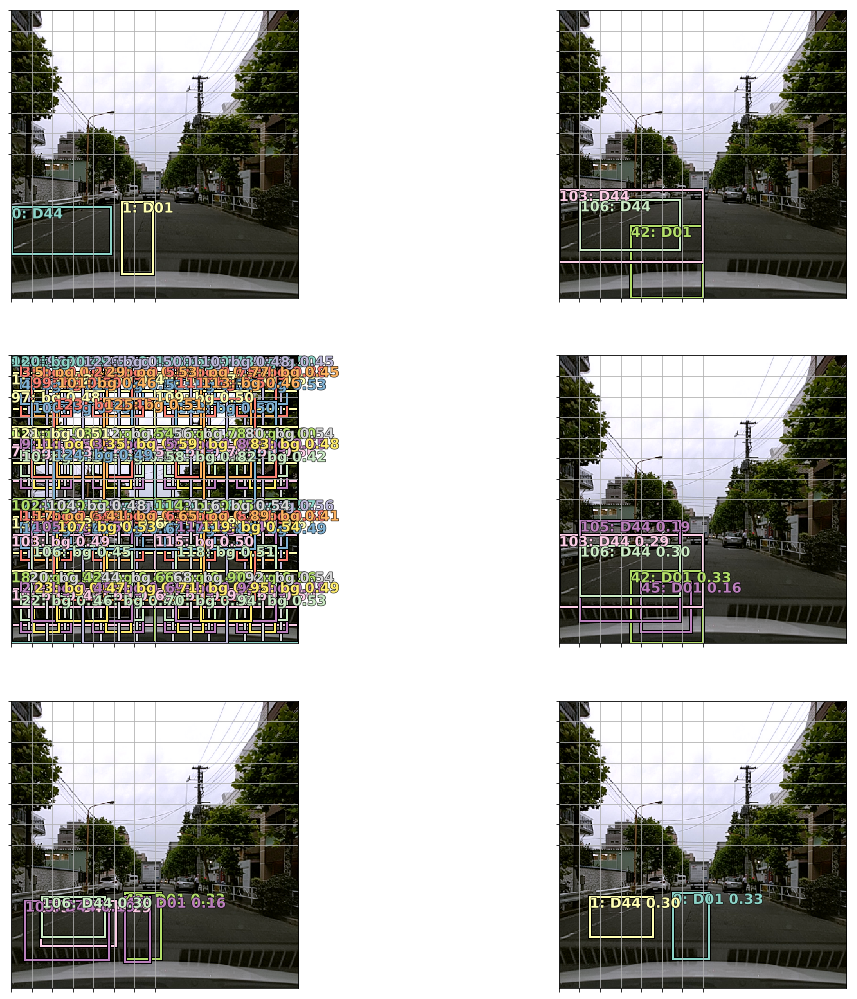

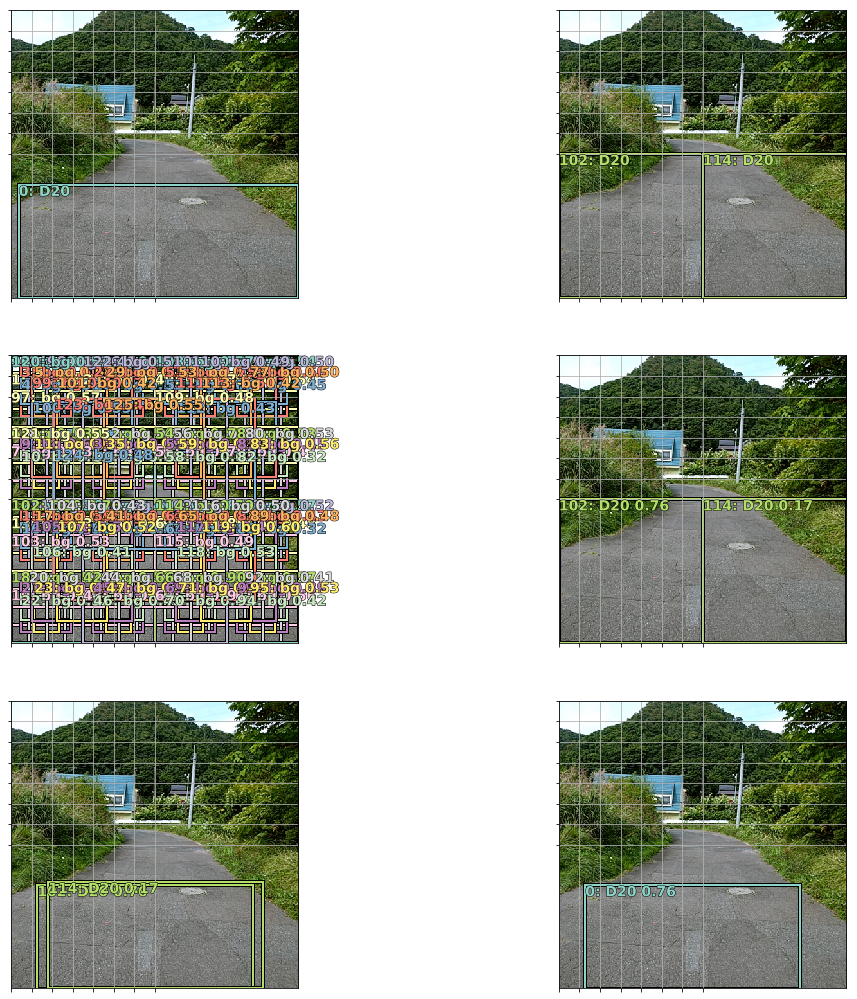

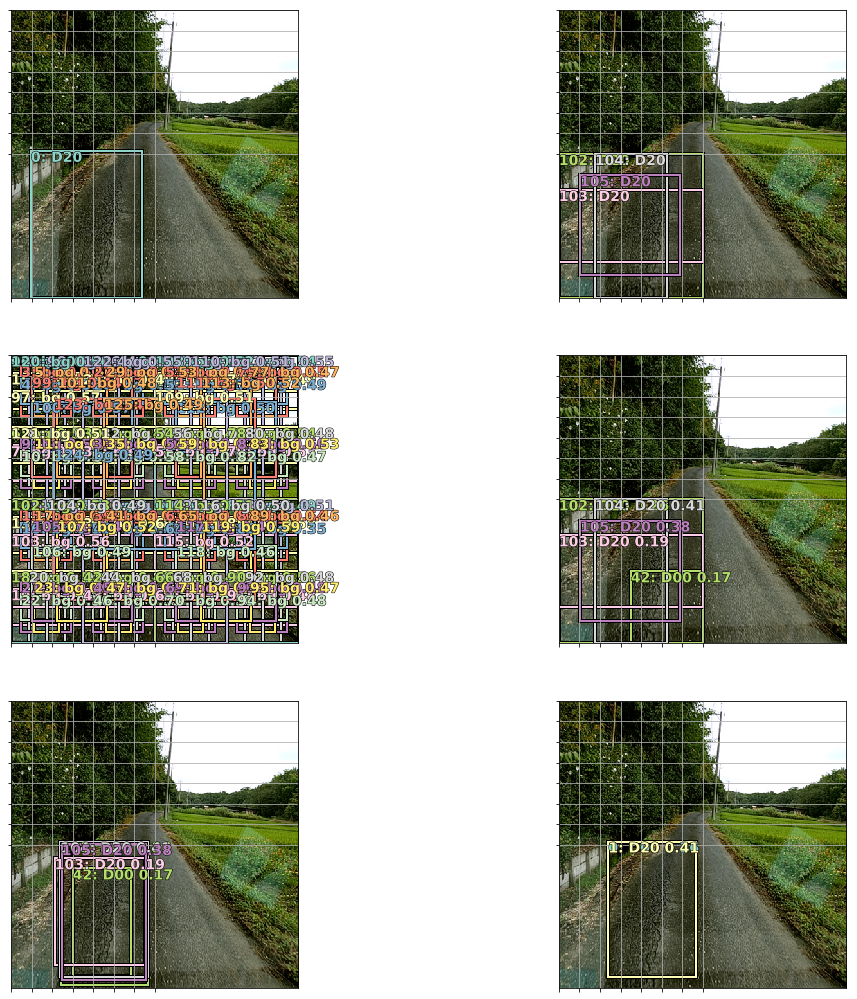

In [55]:
test(sess, anchors, grid_sizes, data['valid'])

## Inference Test Data

In [ ]:
def inference_test_data():
    inferences = []

    prints = 0

    with EvalModel(sess.model):
        for x,y,meta in data['test']:
            pred_classes, bb_outputs = sess.forward(x)
            for idx, file in enumerate(meta['file']):
                nms_classes, nms_conf, nms_bbs = make_output(pred_classes[idx], bb_outputs[idx], anchors, grid_sizes)

                if prints < 16 and random.random() <= .01:
                    fig, ax = plt.subplots(figsize=(12,12))
                    ax.set_title(file.split("\\")[-1])
                    im = denorm(x[idx]).numpy()
                    nms_bbs_as_numpy = torch_corners_to_center(nms_bbs.cpu()).numpy()
                    torch_gt(ax, im, nms_bbs_as_numpy, nms_classes.cpu().numpy(), nms_conf.cpu().numpy())
                    prints += 1

                nms_classes, nms_conf, nms_bbs = nms_classes.cpu().numpy(), nms_conf.cpu().numpy(), nms_bbs.cpu().numpy()   

                preds = []

                for idx, cls, bb in zip(range(5), nms_classes, nms_bbs):
                    corners = (bb * 600).clip(0,600).astype(int)
                    assert(corners[0] < corners[2] and corners[1] < corners[3])
                    preds.append(f'{cls} {" ".join(corners.astype(str))}')

                inferences.append({'filename': file.split("\\")[-1], 'prediction': " ".join(preds)})

    df = pd.DataFrame(inferences, columns=['filename', 'prediction'])
    df.to_csv(f'Submissions/submission.{time.strftime("%Y%m%d-%H%M%S")}.csv', header=False, index=False)

In [ ]:
inference_test_data()